# Show reconstruction 

In [1]:
import os.path as osp
import torch
import torch.optim as optim
import numpy as np

from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

from im2mesh import data, config
from im2mesh.checkpoints import CheckpointIO
import plotly.express as px
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objects as go

In [2]:
root_path = '../'
stereo_cfg = config.load_config(osp.join(root_path, 'configs/stereo/onet_stereo_recon.yaml'), osp.join(root_path, 'configs/default.yaml'))
mono_cfg = config.load_config(osp.join(root_path, 'configs/stereo/onet_mono_recon.yaml'), osp.join(root_path, 'configs/default.yaml'))
val_dataset = config.get_dataset('val', stereo_cfg)

vis_loader = torch.utils.data.DataLoader(
    val_dataset, batch_size=12, shuffle=True,
    collate_fn=data.collate_remove_none,
    worker_init_fn=data.worker_init_fn)

# -- Stereo model -- #
stereo_model = config.get_model(stereo_cfg, device=torch.device('cuda'), dataset=val_dataset)

optimizer = optim.Adam(stereo_model.parameters(), lr=1e-4)
out_dir = '../out/img/onet_stereo/'
checkpoint_io = CheckpointIO(out_dir, model=stereo_model, optimizer=optimizer)
try:
    load_dict = checkpoint_io.load('model.pt')
except FileExistsError:
    load_dict = dict()

# -- Monocular model -- #
mono_model = config.get_model(mono_cfg, device=torch.device('cuda'), dataset=val_dataset)
optimizer = optim.Adam(mono_model.parameters(), lr=1e-4)
out_dir = '../out/img/onet_mono/'
checkpoint_io = CheckpointIO(out_dir, model=mono_model, optimizer=optimizer)
try:    
    load_dict = checkpoint_io.load('model.pt')
except FileExistsError:
    load_dict = dict()

init_notebook_mode()

../out/img/onet_stereo/model.pt
=> Loading checkpoint from local file...


/home/elchun/miniconda3/envs/stereo-occ/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning:

The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.

/home/elchun/miniconda3/envs/stereo-occ/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning:

Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.



../out/img/onet_mono/model.pt
=> Loading checkpoint from local file...


In [3]:
# -- From the visualize script -- #
def make_3d_grid(bb_min, bb_max, shape):
    ''' Makes a 3D grid.

    Args:
        bb_min (tuple): bounding box minimum
        bb_max (tuple): bounding box maximum
        shape (tuple): output shape
    '''
    size = shape[0] * shape[1] * shape[2]

    pxs = torch.linspace(bb_min[0], bb_max[0], shape[0])
    pys = torch.linspace(bb_min[1], bb_max[1], shape[1])
    pzs = torch.linspace(bb_min[2], bb_max[2], shape[2])

    pxs = pxs.view(-1, 1, 1).expand(*shape).contiguous().view(size)
    pys = pys.view(1, -1, 1).expand(*shape).contiguous().view(size)
    pzs = pzs.view(1, 1, -1).expand(*shape).contiguous().view(size)
    p = torch.stack([pxs, pys, pzs], dim=1)

    return p

def visualize(stereo_model, mono_model, data, threshold = 0.5):
    ''' Performs a visualization step for the data.

    Args:
        data (dict): data dictionary
    '''
    device = torch.device('cuda')

    batch_size = data['points'].size(0)
    inputs = data.get('inputs', torch.empty(batch_size, 0))

    if type(inputs) == dict:
        for k, v in inputs.items():
            inputs[k] = v.to(device)
    else:
        inputs = inputs.to(device)

    shape = (32, 32, 32)
    p = make_3d_grid([-0.5] * 3, [0.5] * 3, shape).to(device)
    p = p.expand(batch_size, *p.size())

    kwargs = {}
    with torch.no_grad():
        p_r_stereo = stereo_model(p, inputs, sample=False, **kwargs)
        mono_inputs = inputs['l_image']
        p_r_mono = mono_model(p, mono_inputs, sample=False, **kwargs)


    occ_hat_stereo = p_r_stereo.probs.view(batch_size, *shape)
    voxels_out_stereo = (occ_hat_stereo >= threshold).cpu().numpy()

    occ_hat_mono = p_r_mono.probs.view(batch_size, *shape)
    voxels_out_mono = (occ_hat_mono >= threshold).cpu().numpy()

    if type(inputs) == dict:
        inputs = torch.cat([inputs['l_image'], inputs['r_image']], dim=1)

    for i in range(batch_size):
        data_l = inputs[:, :3, :, :]
        data_r = inputs[:, 3:, :, :]
        # print(data_r.shape)
        data = torch.cat([data_l, data_r], dim=3).cpu().numpy()
        data = data[i]
        data = np.einsum('ijk->jki', data)

        fig = plt.figure()
        ax = fig.add_subplot()
        ax.imshow(data)
        plt.show(fig)
        plt.close(fig)

        fig = plt.figure()
        ax = fig.add_subplot()
        ax.imshow(np.einsum('ijk->jki', mono_inputs[i].cpu().numpy()))
        plt.show(fig)
        plt.close(fig)


        # -- PLOT TEST -- #
        # Use numpy
        voxels = np.asarray(voxels_out_stereo[i])
        # Create plot
        fig = plt.figure()
        ax = fig.add_subplot(projection=Axes3D.name)
        voxels = voxels.transpose(2, 0, 1)
        ax.voxels(voxels, edgecolor='k')
        ax.set_xlabel('Z')
        ax.set_ylabel('X')
        ax.set_zlabel('Y')
        ax.view_init(elev=30, azim=0)
        plt.title('Stereo Reconstruction')
        plt.show()
        plt.close(fig)
        # -- END PLOT TEST -- #
        
        # -- PLOT MONO -- #
        # Use numpy
        voxels = np.asarray(voxels_out_mono[i])
        # Create plot
        fig = plt.figure()
        ax = fig.add_subplot(projection=Axes3D.name)
        voxels = voxels.transpose(2, 0, 1)
        ax.voxels(voxels, edgecolor='k')
        ax.set_xlabel('Z')
        ax.set_ylabel('X')
        ax.set_zlabel('Y')
        ax.view_init(elev=30, azim=0)
        plt.title('Monocular Reconstruction')
        plt.show()
        plt.close(fig)

    # points = np.meshgrid(np.arange(32), np.arange(32), np.arange(32))
    # print(points.shape)

    # print(voxels_out.shape)
    # print(p.shape)

    # fig = px.scatter_3d()

    # fig.add_trace(go.Scatter3d(
    #     x=voxels_out[:, 0], y=voxels_out[:, 1], z=voxels_out[:, 2],
    #     mode='markers', 
    #     marker=dict(color='rgba(255, 106, 100, 1.0)', size=1)
    # ))
    # fig.update_layout(scene_aspectmode='data')
    # iplot(fig)

    # print(voxels_out)

In [ ]:
print(stereo_model)
print(mono_model)

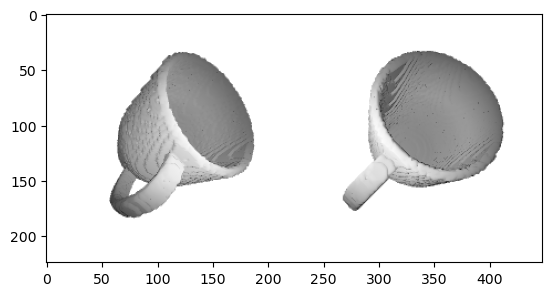

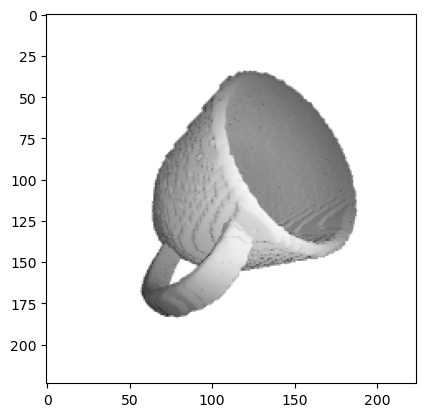

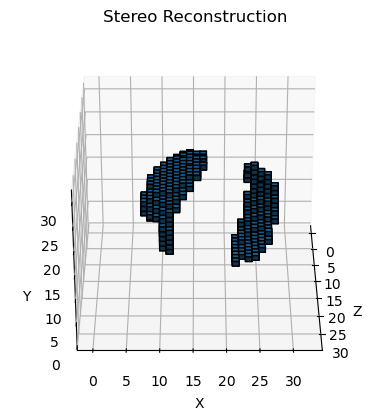

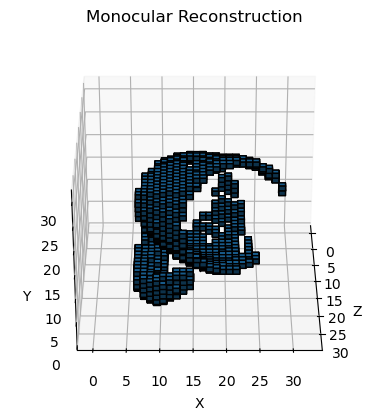

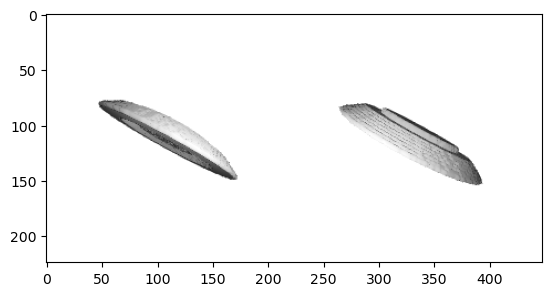

...

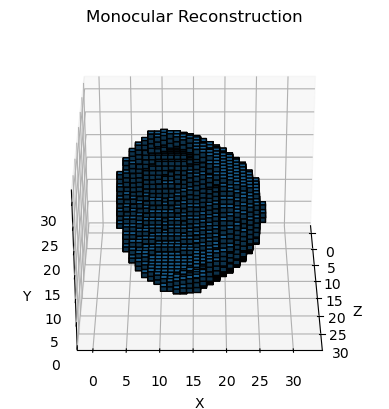

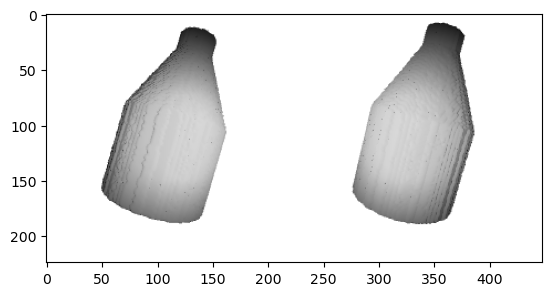

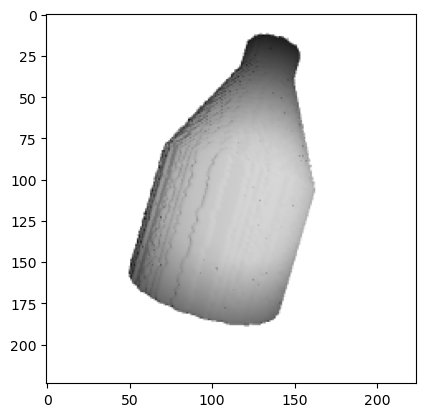

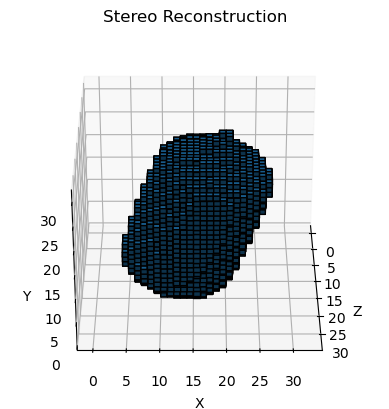

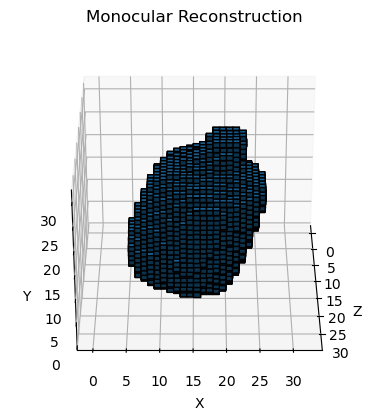

In [7]:
data_vis = next(iter(vis_loader))
visualize(stereo_model, mono_model, data_vis)
# u_continue = input('Continue? (y/n)')
# if u_continue == 'n':
#     break


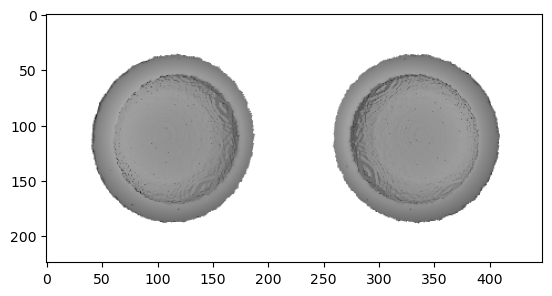

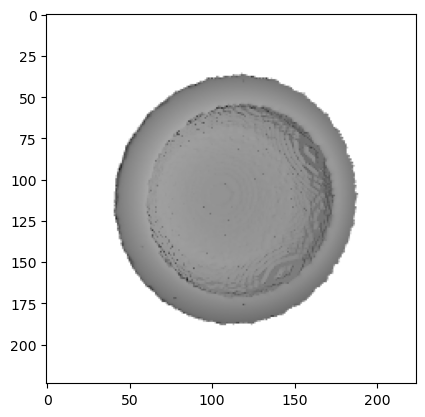

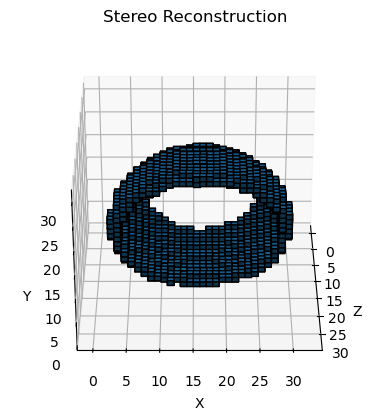

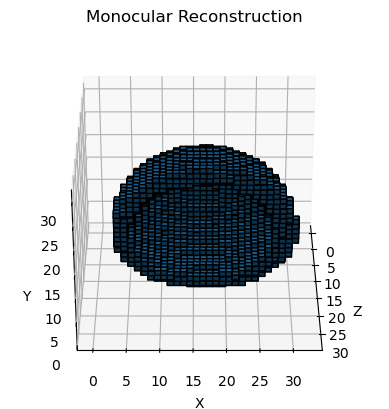

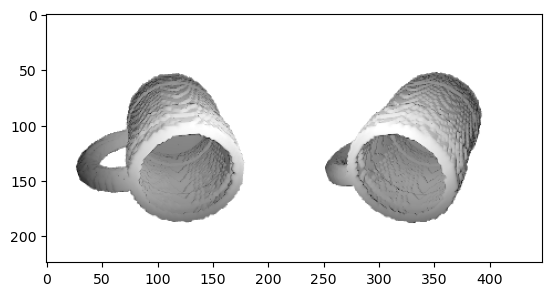

...

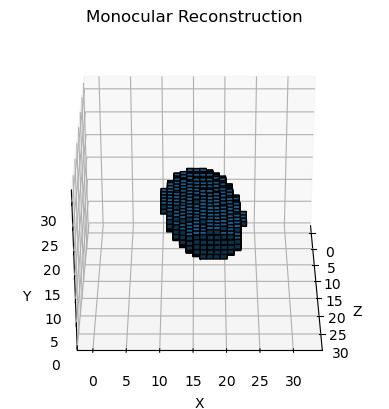

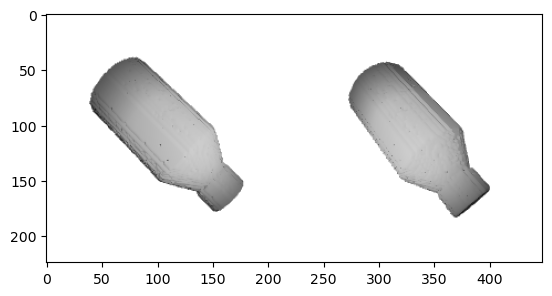

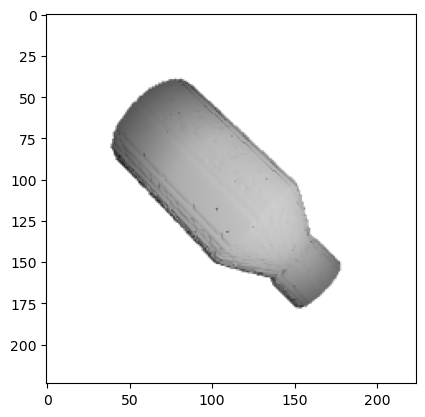

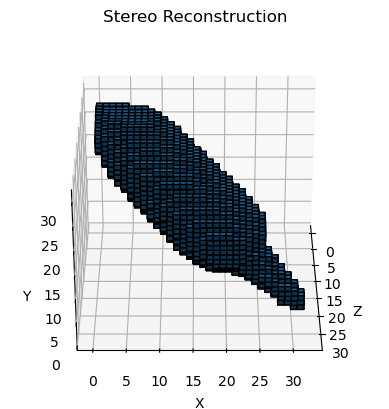

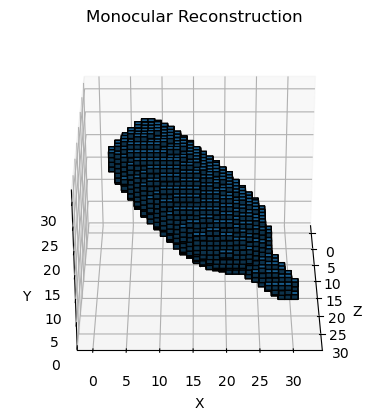

In [8]:
data_vis = next(iter(vis_loader))
visualize(stereo_model, mono_model, data_vis)

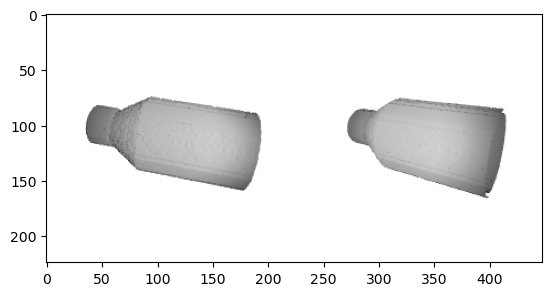

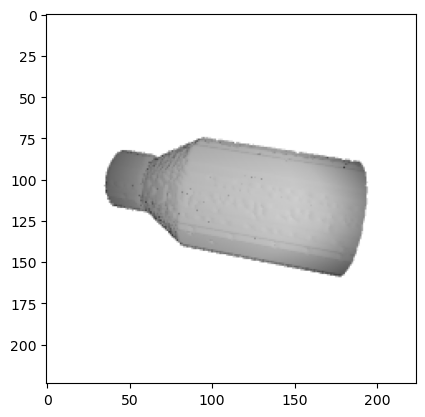

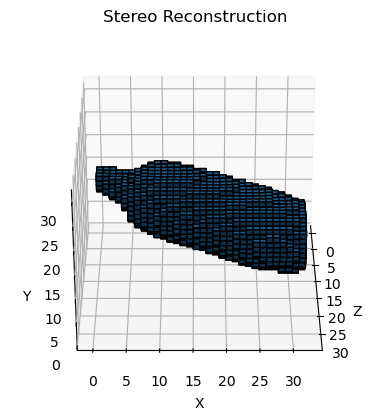

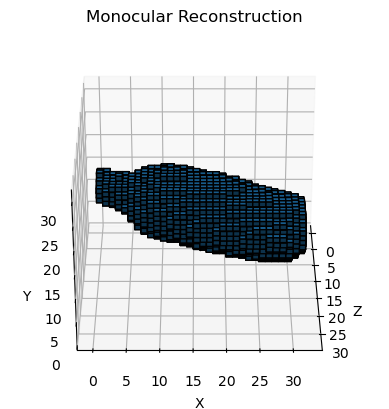

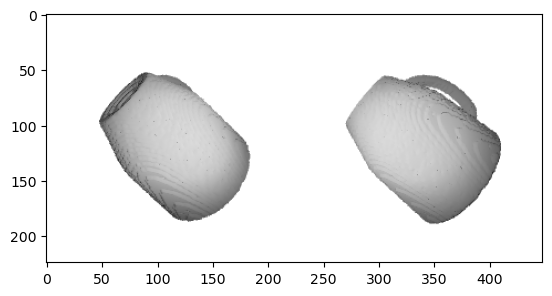

...

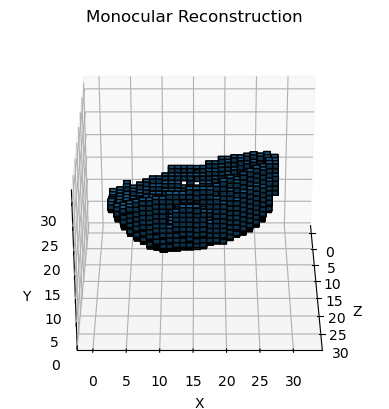

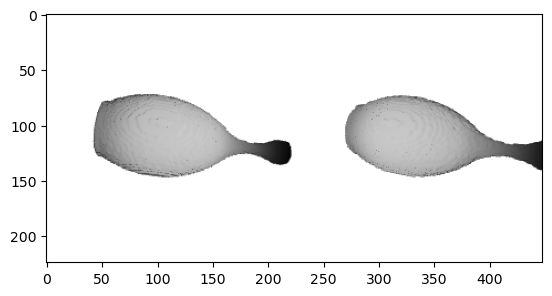

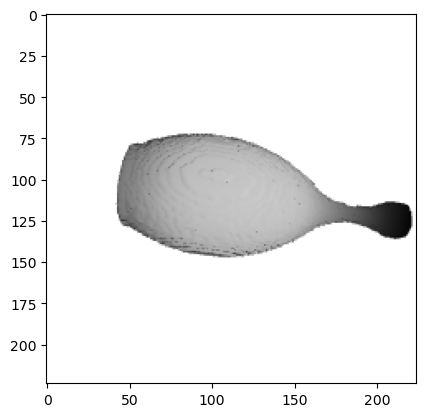

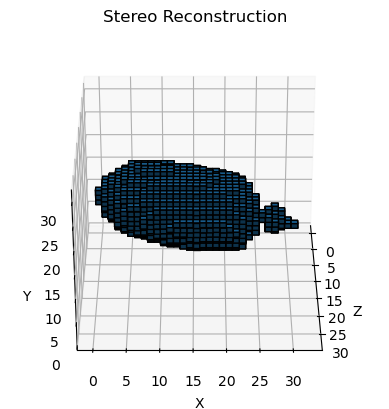

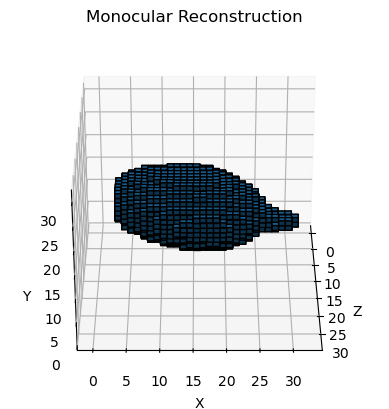

In [9]:
for batch_idx in range(5):
    data_vis = next(iter(vis_loader))
    visualize(stereo_model, mono_model, data_vis)